### Characterizing bursting dynamics of links (plotting results)

In [38]:
# Path to the toolbox
import sys; sys.path.insert(1, '/home/vinicius/storage1/projects/GrayData-Analysis')
import os 

# GDa functions
import GDa.stats.bursting                as     bst
from   GDa.session                       import session
from   GDa.temporal_network              import temporal_network
from   GDa.util                          import smooth

import matplotlib.pyplot                 as     plt
import matplotlib
import GDa.graphics.plot                 as     plot

from   mne.viz                           import circular_layout, \
                                                plot_connectivity_circle

import numpy                             as     np
import xarray                            as     xr


from   tqdm                              import tqdm
from   sklearn.manifold                  import TSNE
from   scipy                             import stats

#### Plotting and file saving configurations

In [2]:
SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE = plot.set_plot_config()

In [3]:
# Create directory to save figures
if not os.path.exists("img/n5.0.0"):
    os.makedirs("img/n5.0.0")

In [4]:
# Bands names
band_names  = [r'band 1', r'band 2', r'band 3', r'band 4', r'band 5']
stages      = ['baseline', 'cue', 'delay', 'match']
_stats      = [r"$\mu$","std$_{\mu}$",r"$\mu_{tot}$","CV"]

In [5]:
### Methods to read coherence files
def get_coh_file(ks=None, surr=False, mode="morlet"):
    if surr:
        _COH_FILE = f'super_tensor_s{12000}_k{ks}_{mode}.nc'
    else:
        _COH_FILE = f'super_tensor_k{ks}_{mode}.nc'
    return _COH_FILE

### Methods to read burst stats files
def get_bst_file(ks=None, surr=False, rel=False, mode="morlet"):
        return f'~/storage1/projects/GrayData-Analysis/Results/lucy/150128/session01/bs_stats_k_{ks}_surr_{surr}_rel_{rel}_numba_{mode}.nc'

### Visualizing the super tensor

#### Loading session and setting coherence parameters

In [6]:
# Parameters to read the data
idx      = 3 
nses     = 1
nmonkey  = 0
align_to = 'cue'

dirs = { 'rawdata':'/home/vinicius/storage1/projects/GrayData-Analysis/GrayLab',
         'results':'Results/',
         'monkey' :['lucy', 'ethyl'],
         'session':'session01',
         'date'   :[['141014', '141015', '141205', '150128', '150211', '150304'], []] }

In [7]:
#  Instantiating session
ses   = session(raw_path = dirs['rawdata'], monkey = dirs['monkey'][nmonkey], date = dirs['date'][nmonkey][idx],
                session = nses, slvr_msmod = False, align_to = align_to, evt_dt = [-0.65, 3.00])
# Load data
ses.read_from_mat()

In [8]:
# Smoothing windows
sm_times  = 500
sm_freqs  = 1 
sm_kernel = "square"

# Defining parameters
delta = 15       # Downsampling factor
mode  = 'morlet' # ("morlet", "mt_1", "mt_2")
foi   = np.array([
        [0.1, 6.],
        [6., 14.],
        [14., 26.],
        [26., 42.],
        [42., 80.]
            ])

if mode in ["morlet", "mt_1"]:
    n_freqs = 50
    freqs = np.linspace(foi[0,0], foi[-1,1], n_freqs, endpoint=True)
    n_cycles     = freqs/2
    mt_bandwidth = None
    decim_at='tfd'
elif mode == "multitaper":
    freqs = foi.mean(axis=1)
    W     = np.ceil( foi[:,1]-foi[:,0] )   # Bandwidth
    foi   = None
    n_cycles     = np.array([3, 5, 9, 12, 16])
    mt_bandwidth = np.array([2, 4, 4.28, 5.647, 9.65])
    decim_at     = 'coh'

When instantiated, the temporal network object will load the recording info for the monkey, date, and session specified as well as the super tensor; The trial type and the behavioral response can also be specified.

The super-tensor has dimensions [Number of pairs, Number of frequency bands, Number of trials, Time]. For Lucy the frequency bands analysed are:

- band $1$  = [0.1,6]  Hz;
- band $2$  = [6,14]   Hz;
- band $3$  = [14,26]  Hz;
- band $4$  = [26,42]  Hz;
- band $5$  = [42,80]  Hz;

The __temporal_network__ class can also be instantiated by setting threshold as __True__ this will automatically threshold the super-tensor (computed for all trial types independent on how the trial type parameter was set).

### Panel with supertensor, ERP and t-sne projection (q=0.8)

In the cells bellow we perform the burstness analysis for the default thresholding parameter.

In [9]:
def plot_erp(ax, net, i):
    """
    Plot ERP at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    # Average activation sequences over links
    mu_filtered_super_tensor = net.super_tensor.mean(dim='roi')
    for t in range(net.super_tensor.shape[2]):
        plt.plot(net.time, 
        mu_filtered_super_tensor.isel(trials=t, freqs=i).values, 
        color='b', lw=.1)
    plt.plot(net.time, 
             mu_filtered_super_tensor.isel(freqs=i).median(dim='trials'),
            color='k', lw=3)
    plt.plot(net.time, 
         mu_filtered_super_tensor.isel(freqs=i).quantile(q=5/100,dim='trials'),
        color='r', lw=3)
    plt.plot(net.time, 
    mu_filtered_super_tensor.isel(freqs=i).quantile(q=95/100,dim='trials'),
    color='r', lw=3)
    plt.xlim([net.time[0],net.time[-1]])

def plot_tsne(ax, net, i):
    """
    Plot the t-sne projection at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    aux = net.super_tensor.isel(freqs=i, trials=slice(0,50))
    aux = aux.stack(observations=("trials","times"))
    Y = TSNE(n_components=2, 
             metric='hamming', 
             perplexity=30.0,
             square_distances=True,
             n_jobs=20).fit_transform(aux.T)
    for i in range(len(stages)):
        plt.plot(Y[net.s_mask[stages[i]][:50*len(net.time)],0], 
                 Y[net.s_mask[stages[i]][:50*len(net.time)],1], 
                 '.', ms=2, label = stages[i])
        plt.legend()

In [10]:
def plot_erp_panel(_KS=None, _SURR=False, _REL=False, title=None):
    # Instantiate network
    q_thr = 0.8
    ## Default threshold
    kw = dict(q=q_thr, keep_weights=False, relative=_REL)

    # Instantiating a temporal network object without thresholding the data
    net =  temporal_network(coh_file=get_coh_file(ks=_KS, surr=_SURR, mode=mode), monkey=dirs['monkey'][nmonkey], 
                            session=1, date='150128', trial_type=[1],
                            behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                            verbose=True, **kw)
    # Mask to track observations within a task-stage
    net.create_stage_masks(flatten=True)

    
    # Plot panel
    fig = plt.figure(figsize=(10, 7), dpi=600)

    gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.95, bottom=0.5, top=0.95)
    gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,0.001,0.6), left=0.05, right=0.95, bottom=0.08, top=0.4)
    # Panel A
    ax1 = plt.subplot(gs1[0])
    plt.sca(ax1)
    plt.imshow(net.super_tensor[:,1,:10,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 10*len(net.time), 1, net.super_tensor.sizes['roi']], vmin=0, vmax=1)
    plt.ylabel("Edge index", fontsize=SMALL_SIZE)
    plt.xlabel('Time [a.u]', fontsize=SMALL_SIZE)
    # Panel B
    ax2 = plt.subplot(gs2[0])
    ax3 = plt.subplot(gs2[2])

    plot_erp(ax2,  net, 1)
    plt.ylabel(r'$\langle C_{ij} \rangle$', fontsize=SMALL_SIZE)
    plt.xlabel('Time [s]', fontsize=SMALL_SIZE)
    plot_tsne(ax3, net, 1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r"tsne$_x$")
    plt.ylabel(r"tsne$_y$")

    bg = plot.Background(visible=False)
    plot.add_panel_letters(fig, axes=[ax1, ax2, ax3], fontsize=18,
                           xpos=[-0.045,-0.1,-0.13], ypos=[1.0, 1.0, 1.0]);
    
    bg.axes.text(0.50, 1.0, title, ha='center', fontsize=MEDIUM_SIZE)

    plt.savefig(f"img/n5.0.0/figure0_surr_{_SURR}_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Original data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:28<00:00, 17.69s/it]


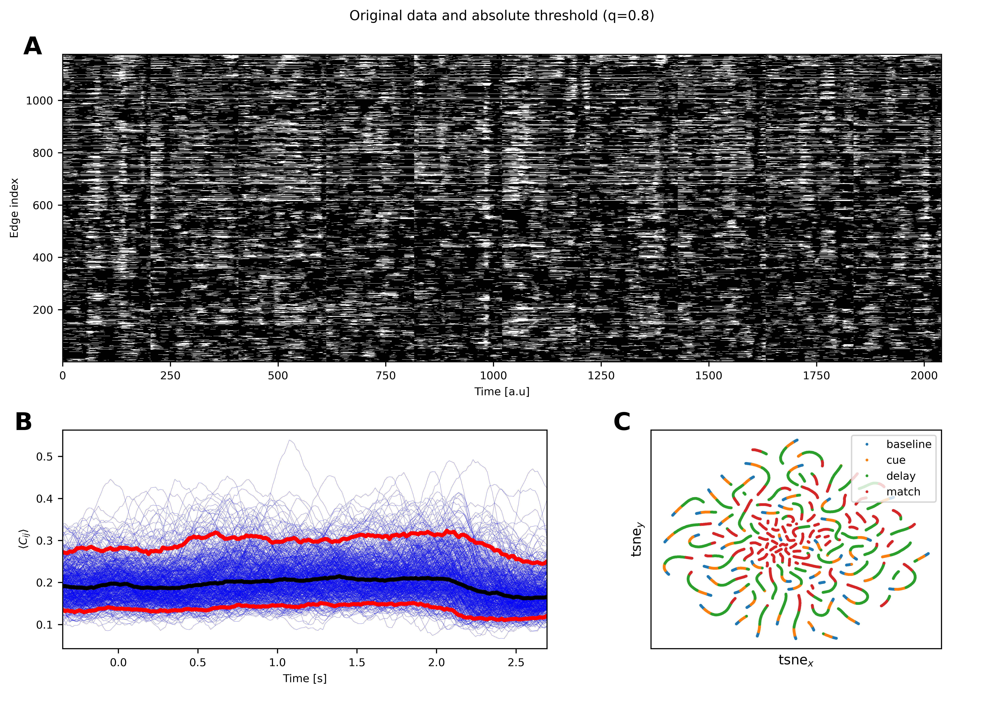

In [11]:
plot_erp_panel(_KS=500, _SURR=False, _REL=False, title=r"Original data and absolute threshold (q=0.8)")

#### Original data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:54<00:00, 10.87s/it]


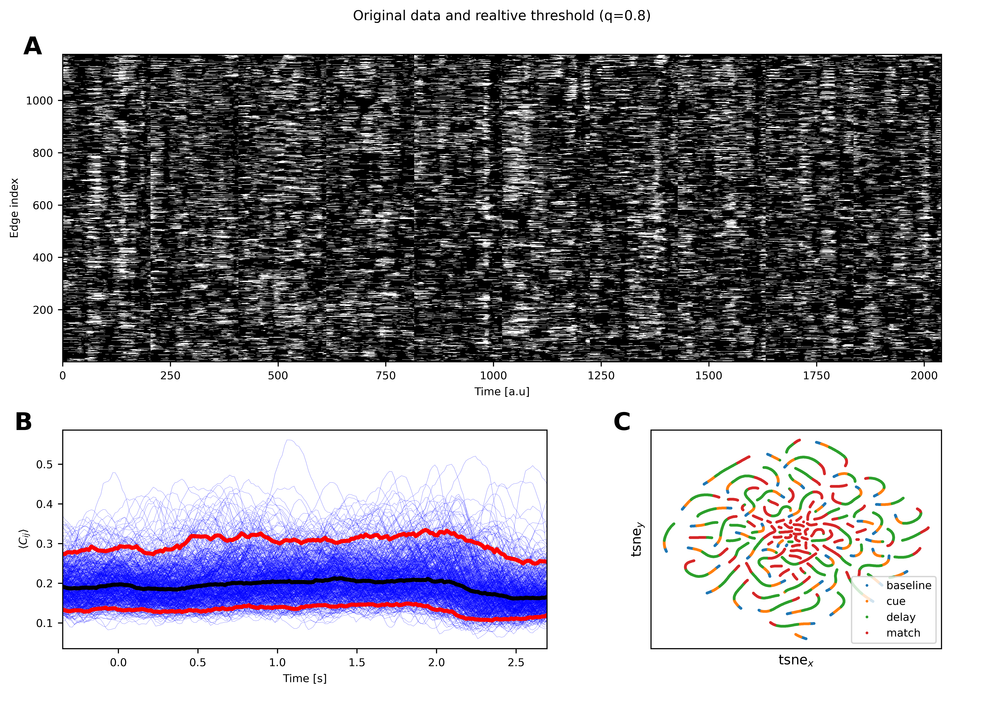

In [12]:
plot_erp_panel(_KS=500, _SURR=False, _REL=True, title=r"Original data and realtive threshold (q=0.8)")

#### Surrogate data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:28<00:00, 17.61s/it]


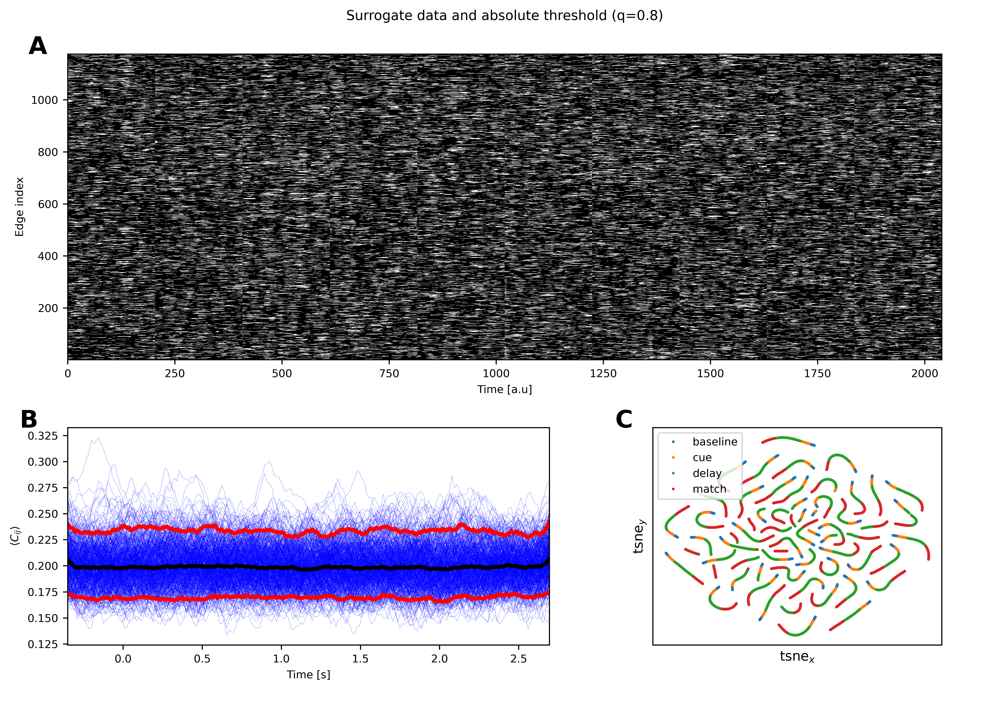

In [13]:
plot_erp_panel(_KS=500, _SURR=True, _REL=False, title=r"Surrogate data and absolute threshold (q=0.8)")

#### Surrogate data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:54<00:00, 10.89s/it]


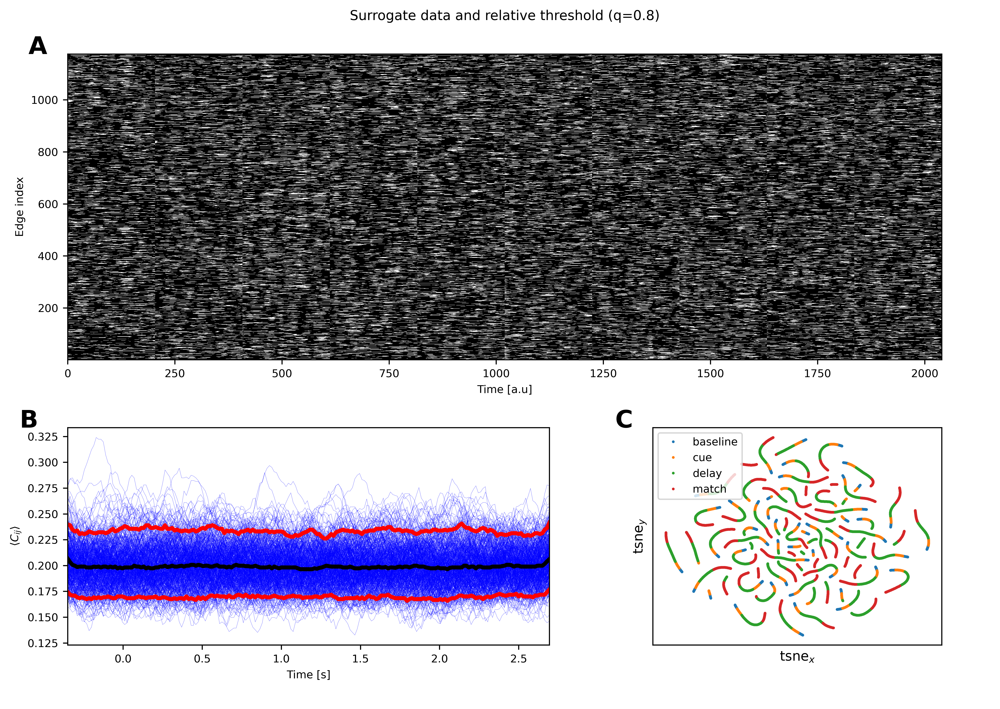

In [14]:
plot_erp_panel(_KS=500, _SURR=True, _REL=True, title=r"Surrogate data and relative threshold (q=0.8)")

### Burstness statistics

In [15]:
def plot_q_dependece(ax, bs_stats,stats,freq,ylabel=None):
    plt.sca(ax)
    # Axis limits
    _xlim0, _xlim1 = bs_stats.thr[0],bs_stats.thr[-1]
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    # Number of edges
    n_edges = bs_stats.sizes["roi"]
    # Compute the median over edges
    _median = bs_stats.isel(stats=stats,freqs=freq).median(dim="roi")
    # Compute the 5% quantile over edges
    _q005   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.05, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    # Compute the 95% quantile over edges
    _q095   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.95, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    for s in range(_median.sizes["stages"]):
        plt.plot(bs_stats.thr, _median.isel(stages=s))
        plt.fill_between(bs_stats.thr, 
                         _q005.isel(stages=s),
                         _q095.isel(stages=s), alpha=0.2)
    plt.vlines(bs_stats.thr.values[1], _ylim0, _ylim1, color="gray")
    plt.vlines(bs_stats.thr.values[6], _ylim0, _ylim1, ls='--', color="gray")
    plt.xlim(_xlim0, _xlim1)
    plt.ylim(_ylim0, _ylim1)
    plt.ylabel(ylabel, fontsize=MEDIUM_SIZE)

def plot_stats_dist(ax, bs_stats, stats, freq, thr, nbins, xlabel=None, legend=None):
    plt.sca(ax)
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    bins=np.linspace(_ylim0, _ylim1,50)
    for i in range(bs_stats.sizes["stages"]):
        plt.hist(bs_stats.isel(stats=stats,stages=i,thr=thr, freqs=freq), bins=bins, density=True, lw=1, histtype='step', fill=False, label=stages[i], orientation='horizontal')
    if isinstance(legend, list):
        plt.legend( prop={'size': 5})
    plt.ylabel(xlabel, fontsize=MEDIUM_SIZE)

In [16]:
def plot_panel_bst(_KS=None, _SURR=False, _REL=False, title=None):
    
    bs_stats = xr.load_dataarray( get_bst_file(ks=_KS, surr=_SURR, rel=_REL, mode=mode) )
    
    
    # For the histograms of each measurement
    nbins  = 100

    fig = plt.figure(figsize=(7, 8), dpi=150)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.1, right=0.95, bottom=0.05, top=0.9, wspace=0.3, hspace=.3)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[3])
    ax3 = plt.subplot(gs1[6])
    ax4 = plt.subplot(gs1[9])

    #### Plotting dependence on threshold of the metrics #####
    plot_q_dependece(ax1, bs_stats, 0, 1, ylabel=_stats[0]+" [s]")
    plt.legend(stages, prop={'size': 5})
    plot_q_dependece(ax2, bs_stats, 1, 1, ylabel=_stats[1]+" [s]")
    plot_q_dependece(ax3, bs_stats, 2, 1, ylabel=_stats[2])
    plot_q_dependece(ax4, bs_stats, 3, 1, ylabel=_stats[3])
    plt.xlabel("q", fontsize=MEDIUM_SIZE)

    # Panel B
    ax5 = plt.subplot(gs1[1])
    ax6 = plt.subplot(gs1[4])
    ax7 = plt.subplot(gs1[7])
    ax8 = plt.subplot(gs1[10])

    ##### Histograms for low threshold ####
    # Mean active time
    plot_stats_dist(ax5, bs_stats, 0, 1, 1, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax6, bs_stats, 1, 1, 1, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax7, bs_stats, 2, 1, 1, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax8, bs_stats, 3, 1, 1, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)

    # Panel C
    ax9  = plt.subplot(gs1[2])
    ax10 = plt.subplot(gs1[5])
    ax11 = plt.subplot(gs1[8])
    ax12 = plt.subplot(gs1[11])

    ##### Histograms for high threshold ####
    # Mean active time
    plot_stats_dist(ax9,  bs_stats, 0, 1, 6, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax10, bs_stats, 1, 1, 6, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax11, bs_stats, 2, 1, 6, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax12, bs_stats, 3, 1, 6, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)
    
    for index in range(12):
        fig.get_axes()[index].spines['right'].set_visible(False)
        fig.get_axes()[index].spines['top'].set_visible(False)

    bg = plot.Background(visible=False)
    #bg.box((0.32, 0.65, 0.01, 0.95), lw=2)
    #bg.box((0.66, 0.99, 0.01, 0.95), lw=2, ls='--')
    bg.axes.text(0.50, 0.96, title, ha='center', fontsize=MEDIUM_SIZE);
    plot.add_panel_letters(fig, axes=[ax1, ax5, ax9], fontsize=18,
                               xpos=[-0.15,-0.15,-0.15], ypos=[1.1, 1.1, 1.1]);
    bg.hline(0.92, x0=0.407, x1=0.637, lw=2)
    bg.hline(0.92, x0=0.71, x1=0.952, lw=2, ls="--")
    plt.savefig(f"img/n5.0.0/qdependence_surr_{_SURR}_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Original data and absolute threshold

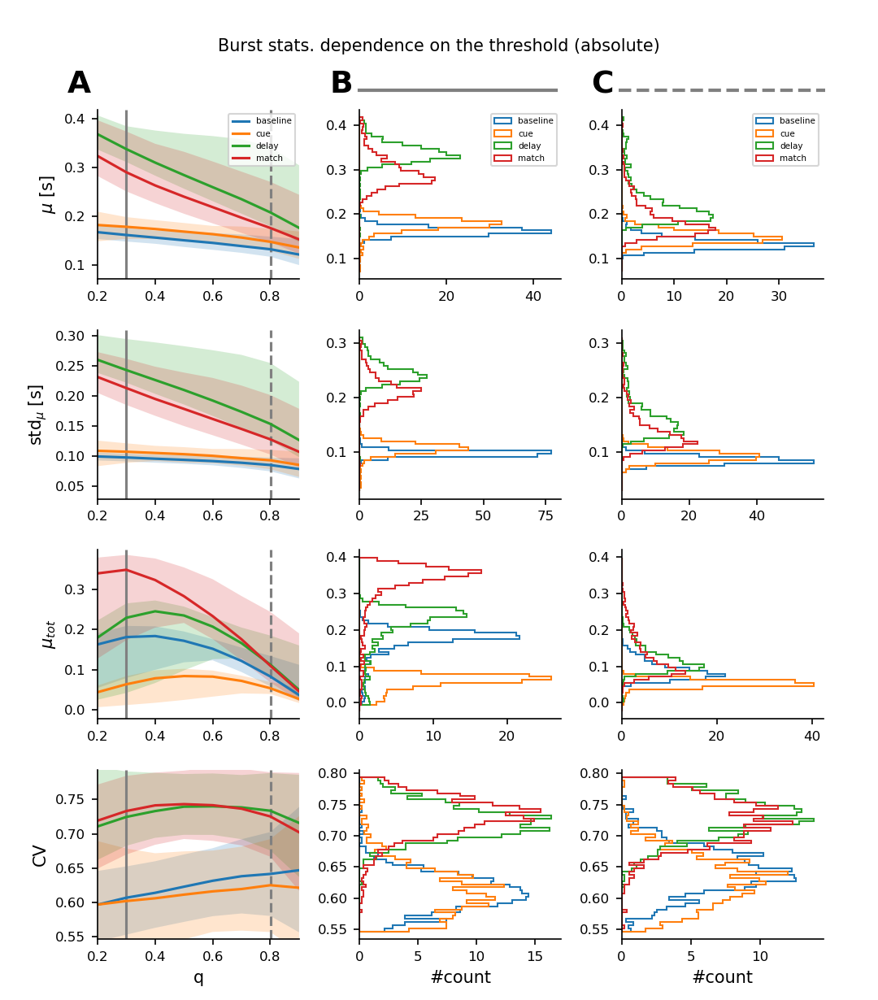

In [17]:
plot_panel_bst(_KS=500, _SURR=False, _REL=False, title="Burst stats. dependence on the threshold (absolute)")

#### Original data and relative threshold

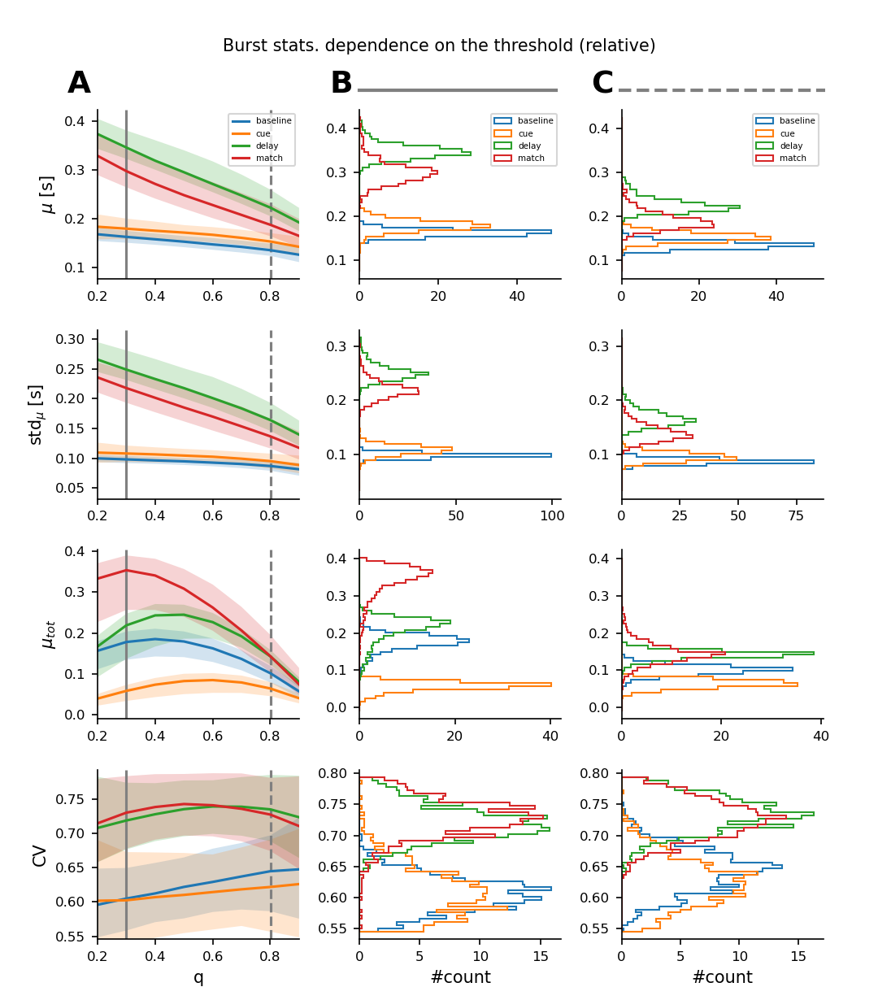

In [18]:
plot_panel_bst(_KS=500, _SURR=False, _REL=True, title="Burst stats. dependence on the threshold (relative)")

#### Surrogate data and absolute threshold

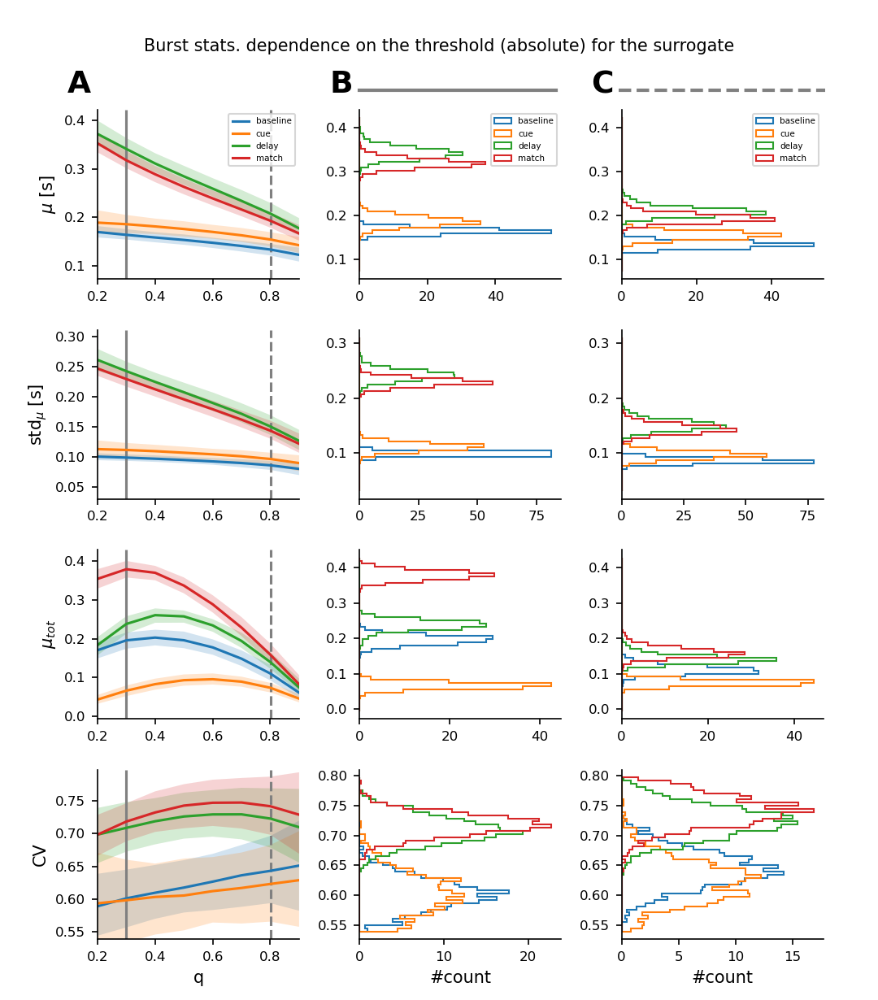

In [19]:
plot_panel_bst(_KS=500, _SURR=True, _REL=False, title="Burst stats. dependence on the threshold (absolute) for the surrogate")

#### Surrogate data and relative threshold

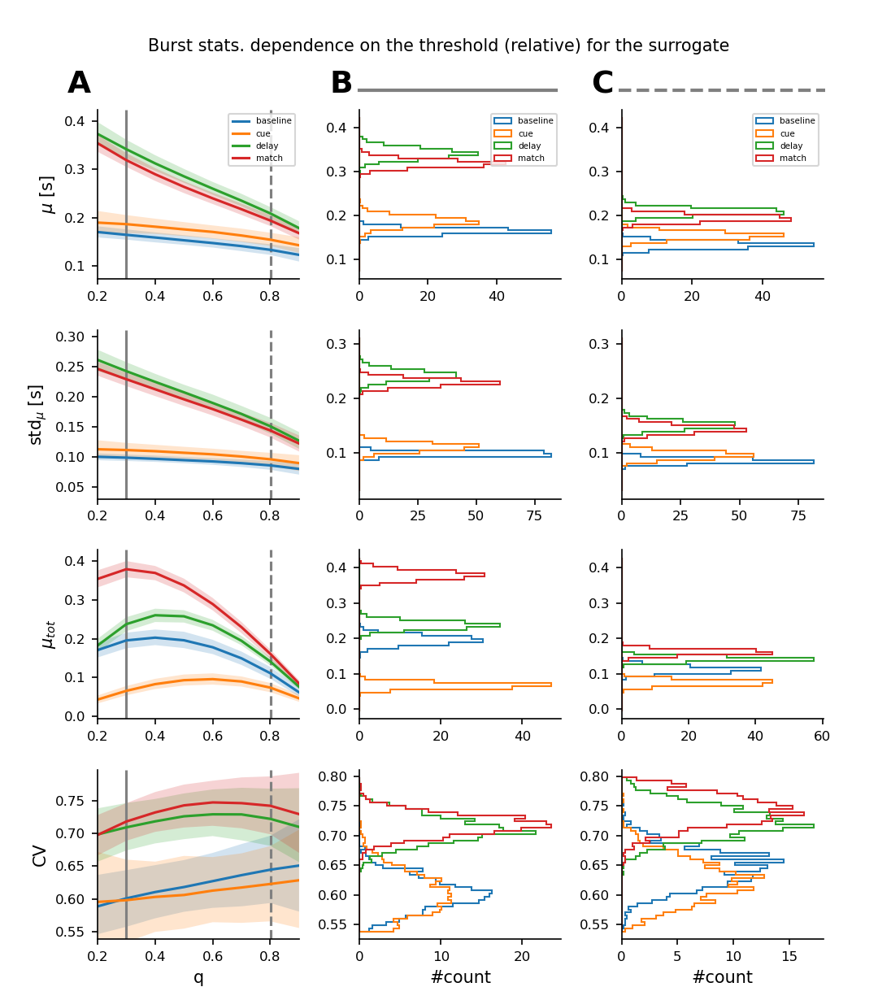

In [20]:
plot_panel_bst(_KS=500, _SURR=True, _REL=True, title="Burst stats. dependence on the threshold (relative) for the surrogate")

### Burstiness statistics - comparison with surrogates

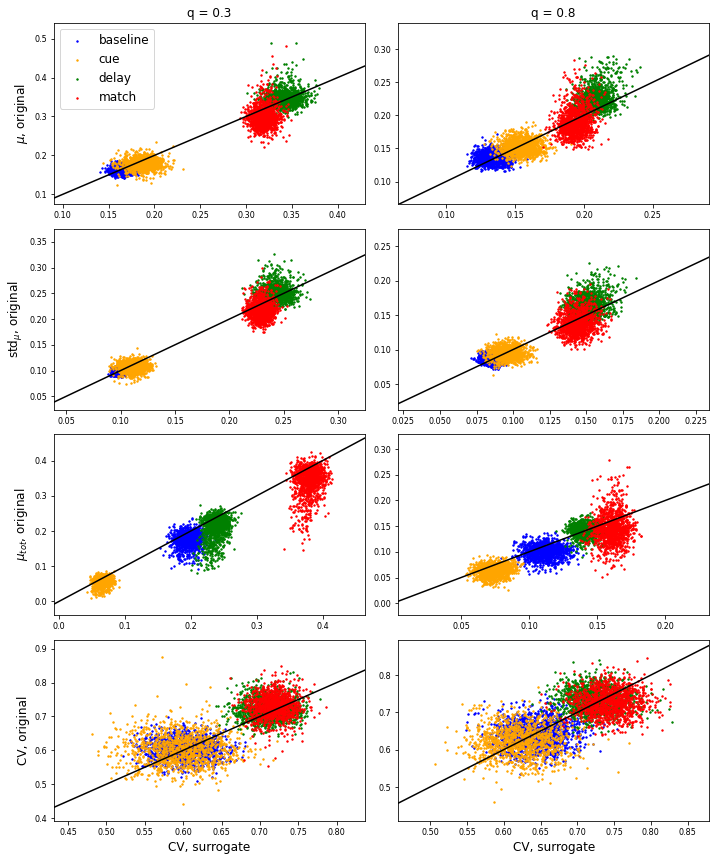

In [37]:
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=True) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=True) )

x = np.linspace(-20,20,100)
y = x

plt.figure(figsize=(10,12))
c     = ['blue', 'orange', 'green', 'red']
count = 1
for i in range(bs_o.sizes["stats"]):
    for q in [1,6]:
        plt.subplot(4,2,count)
        for s in range(4):
            plt.scatter(bs_s.isel(thr=q,stages=s,stats=i, freqs=1), bs_o.isel(thr=q,stages=s,stats=i, freqs=1), c=c[s], s=2, label=f"{stages[s]}")
        plt.xlim(bs_s.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_s.isel(stats=i, thr=q, freqs=1).max()+0.05)
        plt.ylim(bs_o.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_o.isel(stats=i, thr=q, freqs=1).max()+0.05)
        if i==0 and q==1: plt.legend(fontsize=BIGGER_SIZE)
        if i==0 and q==1: plt.title(f"q = {np.round(bs_o.thr.values[q],2)}", fontsize=BIGGER_SIZE)
        if i==0 and q==6: plt.title(f"q = {bs_o.thr.values[q].round(2)}", fontsize=BIGGER_SIZE)
        if q==1: plt.ylabel(f"{_stats[i]}" + ", original", fontsize=BIGGER_SIZE)
        if i==3: plt.xlabel(f"{_stats[i]}" + ", surrogate", fontsize=BIGGER_SIZE)
        plt.plot(x,y, "k")
        count+=1
plt.tight_layout()

In [28]:
bs_s.isel(thr=q,stages=s,stats=i, freqs=1)

<xarray.DataArray (roi: 1176)>
array([0.69758651, 0.7015213 , 0.76336897, ..., 0.70476993, 0.77413072,
       0.75496038])
Coordinates:
  * roi      (roi) object 'a24c-a46V' 'a46D-a46V' 'F7-a46V' ... 'V1-V1' 'V1-V1'
    thr      float64 0.9
    freqs    float64 10.7
    stats    <U2 'CV'
    stages   <U5 'match'

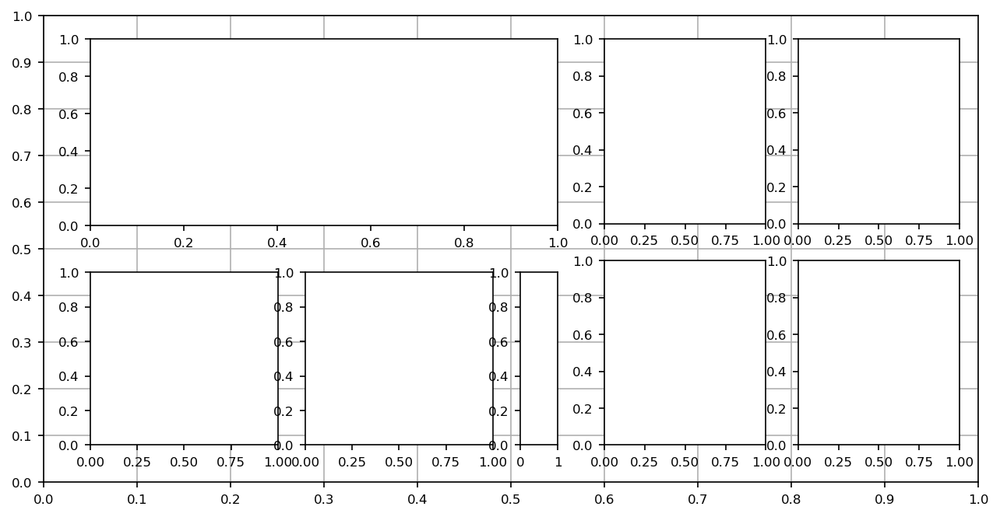

In [22]:
fig = plt.figure(figsize=(8., 4), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.55, bottom=0.55, top=0.95)
gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,1,0.2), left=0.05, right=0.55, bottom=0.08, top=0.45)
gs3 = fig.add_gridspec(nrows=2, ncols=2, left=0.6, right=0.98, bottom=0.08, top=0.95)

ax  = []

# Panel A
ax1 = plt.subplot(gs1[0])

# Panel B
ax2 = plt.subplot(gs2[0])
ax3 = plt.subplot(gs2[1])
ax4 = plt.subplot(gs2[2])

# Panels C-E
ax5 = plt.subplot(gs3[0])
ax6 = plt.subplot(gs3[1])
ax7 = plt.subplot(gs3[2])
ax8 = plt.subplot(gs3[3])

bg = plot.Background(visible=True)

In [42]:
# Instantiate network
q_thr = None
## Default threshold
kw = dict(q=q_thr)

# Instantiating a temporal network object without thresholding the data
net =  temporal_network(coh_file=get_coh_file(ks=500, surr=False, mode="morlet"), monkey=dirs['monkey'][nmonkey], 
                        session=1, date='150128', trial_type=[1],
                        behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                        verbose=True, **kw)

In [60]:
# Extract area names
def _extract_roi(roi, sep):
    # Code by Etiene
    x_s, x_t = [], []
    for r in roi:
        _x_s, _x_t = r.split(sep)
        x_s.append(_x_s), x_t.append(_x_t)
    roi_c = np.c_[x_s, x_t]
    idx = np.argsort(np.char.lower(roi_c.astype(str)), axis=1)
    roi_s, roi_t = np.c_[[r[i] for r, i in zip(roi_c, idx)]].T
    roi_st = [f"{s}{sep}{t}" for s, t in zip(roi_s, roi_t)]
    return roi_s, roi_t, roi_st

In [62]:
x_s, x_t = net.super_tensor.attrs["sources"], net.super_tensor.attrs["targets"]

In [95]:
roi_s, roi_t, _ = _extract_roi(bs_o.roi.values, "-")

In [52]:
mu_mat = np.zeros((net.super_tensor.attrs["nC"],net.super_tensor.attrs["nC"]))

In [88]:
c=0
for i,j in zip(x_s, x_t):
    mu_mat[i,j]=mu_mat[j,i]=bs_s.isel(thr=6,stages=2,stats=0, freqs=1,roi=c)
    c+=1

In [93]:
plot_connectivity_circle(bs_s.isel(thr=6,stages=2,stats=0, freqs=1).values,None, 
                         indices=(x_s,x_t), colormap="hot_r", facecolor="white", vmin=0, vmax=20,node_colors=None,
                         textcolor="k", fig=None, colorbar=None, padding=3, colorbar_size=0.4, colorbar_pos=(-1, 0.5), linewidth=3,
                         title=None, fontsize_title=20,fontsize_names=12, subplot=111, show=False);

TypeError: object of type 'NoneType' has no len()

In [101]:
net.super_tensor

<xarray.DataArray 'coh' (roi: 1176, freqs: 5, trials: 540, times: 204)>
array([[[[0.05076452, 0.03271263, 0.02202706, ..., 0.2796511 ,
          0.2714333 , 0.2619507 ],
         [0.28758475, 0.30873123, 0.32487306, ..., 0.2893926 ,
          0.31019822, 0.33050177],
         [0.42365077, 0.41698036, 0.40802577, ..., 0.1588046 ,
          0.16138953, 0.16514318],
         ...,
         [0.19198723, 0.18109365, 0.17036302, ..., 0.6365137 ,
          0.6151025 , 0.5986255 ],
         [0.6399109 , 0.62074083, 0.5986736 , ..., 0.5226703 ,
          0.5379854 , 0.550896  ],
         [0.5066004 , 0.508825  , 0.5091386 , ..., 0.7566051 ,
          0.7601975 , 0.75942904]],

        [[0.20518294, 0.20173232, 0.20465496, ..., 0.30919552,
          0.30713812, 0.30678928],
         [0.23077539, 0.201376  , 0.17890938, ..., 0.839543  ,
          0.8358238 , 0.83018124],
         [0.5521373 , 0.55173516, 0.5500976 , ..., 0.3684021 ,
          0.3697852 , 0.37239912],
         ...,
         [0.24591719, 0.25037232, 0.2537769 , ..., 0.48066503,
          0.45141095, 0.42647615],
         [0.34636667, 0.32293928, 0.29900965, ..., 0.26995575,
          0.27447802, 0.27948597],
         [0.2427584 , 0.25439167, 0.27328816, ..., 0.3436546 ,
          0.3265863 , 0.30563203]],

        [[0.6098207 , 0.6049115 , 0.6021897 , ..., 0.30821374,
          0.32551053, 0.343276  ],
         [0.27326438, 0.26765528, 0.2610302 , ..., 0.4215851 ,
          0.431542  , 0.44111076],
         [0.2727512 , 0.27452692, 0.2759965 , ..., 0.30384052,
          0.30605027, 0.30672327],
         ...,
         [0.37236428, 0.37657464, 0.37929606, ..., 0.19728218,
          0.19296129, 0.1942754 ],
         [0.3209031 , 0.3220283 , 0.32100314, ..., 0.4840213 ,
          0.50152284, 0.5166566 ],
         [0.21631046, 0.23468827, 0.2549989 , ..., 0.3212889 ,
          0.32579696, 0.32751316]],

        [[0.2961933 , 0.29578558, 0.29622066, ..., 0.31463757,
          0.32110465, 0.3288027 ],
         [0.42864797, 0.42062548, 0.4096449 , ..., 0.28931826,
          0.2958123 , 0.3037798 ],
         [0.2526197 , 0.2557208 , 0.25985366, ..., 0.54769355,
          0.5654438 , 0.5716817 ],
         ...,
         [0.32501438, 0.34190708, 0.35673252, ..., 0.5033775 ,
          0.49609247, 0.49303332],
         [0.27137312, 0.27237716, 0.27202234, ..., 0.44801393,
          0.43139604, 0.41179457],
         [0.18632475, 0.19025579, 0.19445471, ..., 0.24330975,
          0.23981392, 0.23920304]],

        [[0.34933028, 0.34680638, 0.344978  , ..., 0.2632567 ,
          0.26676846, 0.26889712],
         [0.1653408 , 0.16439945, 0.16775963, ..., 0.27276358,
          0.2677858 , 0.26687494],
         [0.2753813 , 0.28408566, 0.29217902, ..., 0.32519   ,
          0.3196988 , 0.31632006],
         ...,
         [0.28430882, 0.29040125, 0.29954994, ..., 0.33422273,
          0.33321026, 0.3343593 ],
         [0.31145954, 0.32539624, 0.3422132 , ..., 0.38503918,
          0.3869473 , 0.3894126 ],
         [0.31146064, 0.3073205 , 0.3048339 , ..., 0.31400588,
          0.29729855, 0.2784274 ]]],


       [[[0.16199967, 0.17815141, 0.20400013, ..., 0.2199446 ,
          0.24166429, 0.2604873 ],
         [0.17241636, 0.16803451, 0.16640583, ..., 0.6618864 ,
          0.6972372 , 0.7243297 ],
         [0.24743949, 0.245919  , 0.24565844, ..., 0.40002057,
          0.40284064, 0.40756437],
         ...,
         [0.48954934, 0.48576325, 0.47665358, ..., 0.7530649 ,
          0.739743  , 0.72811073],
         [0.7148634 , 0.6831579 , 0.6470467 , ..., 0.32716244,
          0.32331353, 0.32002613],
         [0.70309657, 0.6923659 , 0.6796066 , ..., 0.55468166,
          0.55521303, 0.5537831 ]],

        [[0.36414948, 0.35503012, 0.3452382 , ..., 0.24146777,
          0.22768956, 0.2235711 ],
         [0.30703282, 0.26631013, 0.23045455, ..., 0.15410176,
          0.18635882, 0.22012353],
         [0.07631297, 0.07770678, 0.08085036, ..., 0.3011758 ,
          0.2907997 , 0.27928478],
        

In [102]:
net.session_info

{'nT': 750,
 'nC': 49,
 'fsample': 1000.0,
 'channels_labels': array([  1,   4,   9,  13,  16,  17,  22,  23,  26,  27,  29,  34,  39,
         43,  54,  63,  66,  92,  95, 105, 106, 110, 121, 122, 127, 128,
        132, 134, 135, 146, 148, 149, 150, 156, 161, 176, 177, 178, 183,
        201, 203, 205, 210, 219, 221, 224, 242, 248, 250], dtype=int32),
 'stim': array([nan,  2.,  5.,  2.,  4.,  2.,  4.,  2.,  5.,  1.,  3.,  5.,  5.,
         1., nan, nan, nan,  5.,  3.,  3.,  1.,  1.,  5.,  4.,  2.,  1.,
         1., nan,  1.,  2.,  4.,  3.,  3.,  3.,  2., nan,  3.,  2.,  1.,
         3.,  1.,  1., nan,  2.,  4.,  2.,  3.,  1., nan,  3.,  3.,  4.,
         3., nan,  2.,  2.,  4.,  2.,  3.,  1.,  3.,  1.,  5., nan, nan,
         5.,  2.,  2.,  4.,  2., nan,  2.,  5.,  4.,  4.,  2.,  4.,  3.,
         3., nan,  2.,  3.,  1.,  4.,  5., nan,  3.,  4.,  4., nan,  5.,
         3.,  5.,  3.,  2.,  1., nan,  5.,  5.,  4.,  3.,  2.,  2.,  5.,
         1.,  1.,  5.,  2.,  5.,  2., nan,  2.,  5.,  

In [103]:
net.super_tensor.attrs

{'nC': 49,
 'fsample': 1000.0,
 'channels_labels': array([  1,   4,   9,  13,  16,  17,  22,  23,  26,  27,  29,  34,  39,
         43,  54,  63,  66,  92,  95, 105, 106, 110, 121, 122, 127, 128,
        132, 134, 135, 146, 148, 149, 150, 156, 161, 176, 177, 178, 183,
        201, 203, 205, 210, 219, 221, 224, 242, 248, 250], dtype=int32),
 'stim': array([2., 5., 2., 4., 2., 4., 2., 5., 1., 3., 5., 5., 1., 5., 3., 3., 1.,
        1., 5., 4., 1., 1., 1., 2., 4., 3., 3., 3., 2., 3., 2., 1., 3., 1.,
        1., 2., 4., 2., 3., 3., 3., 4., 3., 2., 2., 4., 2., 1., 1., 5., 5.,
        2., 2., 4., 2., 5., 2., 4., 3., 3., 2., 3., 1., 4., 5., 3., 4., 4.,
        5., 3., 5., 3., 2., 1., 5., 5., 4., 3., 2., 2., 5., 1., 1., 5., 2.,
        5., 2., 2., 5., 2., 2., 5., 2., 5., 3., 2., 1., 2., 2., 2., 1., 2.,
        5., 3., 5., 5., 2., 2., 5., 5., 2., 2., 2., 3., 2., 5., 3., 3., 2.,
        2., 3., 2., 2., 5., 5., 2., 5., 1., 2., 2., 1., 1., 4., 4., 1., 5.,
        3., 5., 5., 2., 4., 1., 5., 5., 3.

In [104]:
net.super_tensor.attrs["channels_labels"]

array([  1,   4,   9,  13,  16,  17,  22,  23,  26,  27,  29,  34,  39,
        43,  54,  63,  66,  92,  95, 105, 106, 110, 121, 122, 127, 128,
       132, 134, 135, 146, 148, 149, 150, 156, 161, 176, 177, 178, 183,
       201, 203, 205, 210, 219, 221, 224, 242, 248, 250], dtype=int32)